In [1]:
from __future__ import division, print_function
import sys, os, glob, time, warnings, gc
import matplotlib.pyplot as plt
import numpy as np
from astropy.table import Table, vstack, hstack
import fitsio
from astropy.io import fits
import healpy as hp
from astropy import wcs

from scipy.ndimage.filters import gaussian_filter

In [2]:
params = {'legend.fontsize': 'large',
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large',
         'figure.facecolor':'w'} 
plt.rcParams.update(params)

In [3]:
ccdnamenumdict = {'S1': 25, 'S2': 26, 'S3': 27, 'S4':28,
                  'S5': 29, 'S6': 30, 'S7': 31,
                  'S8': 19, 'S9': 20, 'S10': 21, 'S11': 22, 'S12': 23,
                  'S13': 24,
                  'S14': 13, 'S15': 14, 'S16': 15, 'S17': 16, 'S18': 17,
                  'S19': 18,
                  'S20': 8, 'S21': 9, 'S22': 10, 'S23': 11, 'S24': 12,
                  'S25': 4, 'S26': 5, 'S27': 6, 'S28': 7,
                  'S29': 1, 'S30': 2, 'S31': 3,
                  'N1': 32, 'N2': 33, 'N3': 34, 'N4': 35,
                  'N5': 36, 'N6': 37, 'N7': 38,
                  'N8': 39, 'N9': 40, 'N10': 41, 'N11': 42, 'N12': 43,
                  'N13': 44,
                  'N14': 45, 'N15': 46, 'N16': 47, 'N17': 48, 'N18': 49,
                  'N19': 50,
                  'N20': 51, 'N21': 52, 'N22': 53, 'N23': 54, 'N24': 55,
                  'N25': 56, 'N26': 57, 'N27': 58, 'N28': 59,
                  'N29': 60, 'N30': 61, 'N31': 62}
ccdnamenumdict_inv = {aa: bb for bb, aa in ccdnamenumdict.items()}

ccdnum_list = [ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 62]

ccd_ra = [-0.31244368,-0.00214103, 0.30855858,-0.46789986,-0.1573787 , 0.15336207,
  0.4637642 ,-0.62325889,-0.312972  ,-0.00212455, 0.30866507, 0.61908193,
 -0.77859061,-0.46870955,-0.15780883, 0.15334942, 0.46418217, 0.77441054,
 -0.77876058,-0.46892617,-0.15799484, 0.15333136, 0.46448109, 0.77444204,
 -0.93389515,-0.624237  ,-0.31362077,-0.00213867, 0.30892024, 0.61974856,
  0.92929411,-0.93410772,-0.62439031,-0.31379523,-0.00251046, 0.30860373,
  0.61929563, 0.92907893,-0.77928668,-0.46927775,-0.15819325, 0.15315534,
  0.464108  , 0.77408146,-0.7791703 ,-0.46938561,-0.15825837, 0.15269545,
  0.46382537, 0.77383443,-0.6239286 ,-0.31363566,-0.00262614, 0.30814956,
  0.61848423,-0.46862823,-0.15833137, 0.15254403, 0.46295505,-0.31333245,
  0.30765903]

ccd_dec = [ 0.90299039, 0.90274404, 0.90285652, 0.73894001, 0.73933177, 0.73919444,
  0.73865878, 0.5745655 , 0.57508801, 0.57510357, 0.57486577, 0.57414278,
  0.41001556, 0.41059824, 0.41088721, 0.41057117, 0.41032572, 0.40963196,
  0.24595122, 0.24597951, 0.24624207, 0.24619019, 0.24582139, 0.24534302,
  0.08128957, 0.08150002, 0.08130657, 0.08138846, 0.0810964 , 0.08093379,
  0.08089282,-0.08302691,-0.08319348,-0.08340522,-0.08351659,-0.08366242,
 -0.08355805,-0.08365399,-0.24756494,-0.2479717 ,-0.24812127,-0.24835309,
 -0.2482645 ,-0.2480924 ,-0.41173856,-0.41236738,-0.41281328,-0.41296242,
 -0.41270174,-0.41225407,-0.57638265,-0.57687683,-0.57711492,-0.57725814,
 -0.57674114,-0.74071528,-0.74115162,-0.74130891,-0.74095896,-0.9049206 ,
 -0.90515532]

In [4]:
img_old_dir = '/global/project/projectdirs/cosmo/staging/'
img_new_dir = '/global/cscratch1/sd/rongpu/fringe/fringe_corrected_image/'
# img_new_dir = '/global/cscratch1/sd/rongpu/fringe/tmp_img2/'
frgscale_dir = '/global/cscratch1/sd/rongpu/fringe/frgscale/'

# surveyccd_path = '/global/homes/r/rongpu/mydesi/dr9/fringe/misc/survey-ccds-decam-dr9-z-band-only-trim.fits'
surveyccd_path = '/global/project/projectdirs/cosmo/work/legacysurvey/dr9/survey-ccds-decam-dr9-cut.fits.gz'

pix_size = 0.262/3600

In [5]:
# Load CCD list
# ccd_columns = ['image_filename', 'image_hdu', 'expnum', 'ccdname', 'filter', 'ccd_cuts']
# ccd = fitsio.read(surveyccd_path, columns=ccd_columns)
ccd = fitsio.read(surveyccd_path)
ccd = Table(ccd)
mask = ccd['ccd_cuts']==0
mask &= ccd['filter']=='z' # include only z-band images
ccd = ccd[mask]
print(len(ccd))
ccd['ccdnum'] = [ccdnamenumdict[ccd['ccdname'][ii].strip()] for ii in range(len(ccd))]

expnum_list = np.unique(ccd['expnum'])
# shuffle
np.random.seed(123)
# DO NOT USE NP.RANDOM.SHUFFLE
expnum_list = np.random.choice(expnum_list, size=len(expnum_list), replace=False)

1148265


## Plot one exposure

In [7]:
# expnum = expnum_list[0]
expnum = 767653
print('expnum:', expnum)

# Find an arbitrary CCD in the exposure to get the image filename
ccd_index = np.where((ccd['expnum']==expnum))[0][0]

frgscale_path = os.path.join(frgscale_dir, ccd['image_filename'][ccd_index].strip().replace('.fits.fz', '.txt'))
img_old_fn = os.path.join(img_old_dir, ccd['image_filename'][ccd_index].strip())
img_new_fn = os.path.join(img_new_dir, ccd['image_filename'][ccd_index].strip())
print(img_new_fn)

fringe_table = Table.read(frgscale_path, format='ascii.commented_header')

expnum: 767653
/global/cscratch1/sd/rongpu/fringe/fringe_corrected_image/decam/CP/V4.8.2a/CP20180831/c4d_180901_090046_ooi_z_ls9.fits.fz


__Old image__

CCD31 not found in fringe_table


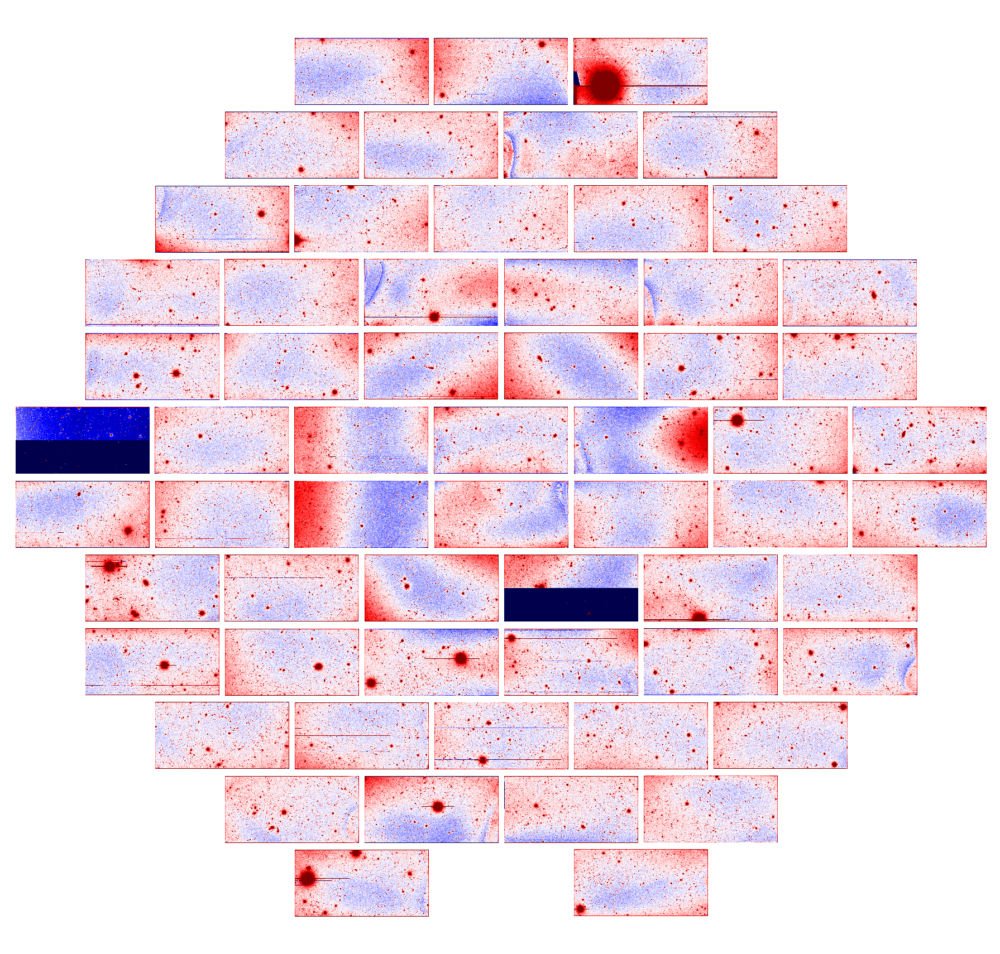

In [7]:
plt.figure(figsize=(25, 23.86))

for ii, ccdnum in enumerate(ccdnum_list):
    
    try:
        img = fits.getdata(img_old_fn, extname=ccdnamenumdict_inv[ccdnum])
    except:
        continue
    ysize, xsize = img.shape        
    ra, dec = ccd_ra[ii], ccd_dec[ii]

    idx = np.where((fringe_table['expnum']==expnum) & (fringe_table['ccdnum']==ccdnum))[0]
    if len(idx)!=1:
        print('CCD{} not found in fringe_table'.format(ccdnum))
        mask = (fringe_table['expnum']==expnum)
        median_sky = np.median(fringe_table['median_sky'][mask])
        sky_nmad = np.median(fringe_table['sky_nmad'][mask])
    else:
        median_sky = fringe_table['median_sky'][idx]
        sky_nmad = fringe_table['sky_nmad'][idx]
    
    img1 = img - median_sky
    img1[~np.isfinite(img1)] = 0
    img1 = gaussian_filter(img1, 3, mode='reflect', truncate=3)
    fig = plt.imshow(img1.T, cmap='seismic', vmin=-1.5*sky_nmad, vmax=1.5*sky_nmad, 
               extent=(ra-ysize*pix_size/2, ra+ysize*pix_size/2, dec-xsize*pix_size/2, dec+xsize*pix_size/2))

plt.axis([1.1, -1.1, -1.05, 1.05])
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
# plt.savefig('old_image.png')
plt.show()

__New image__

CCD31 not found in fringe_table


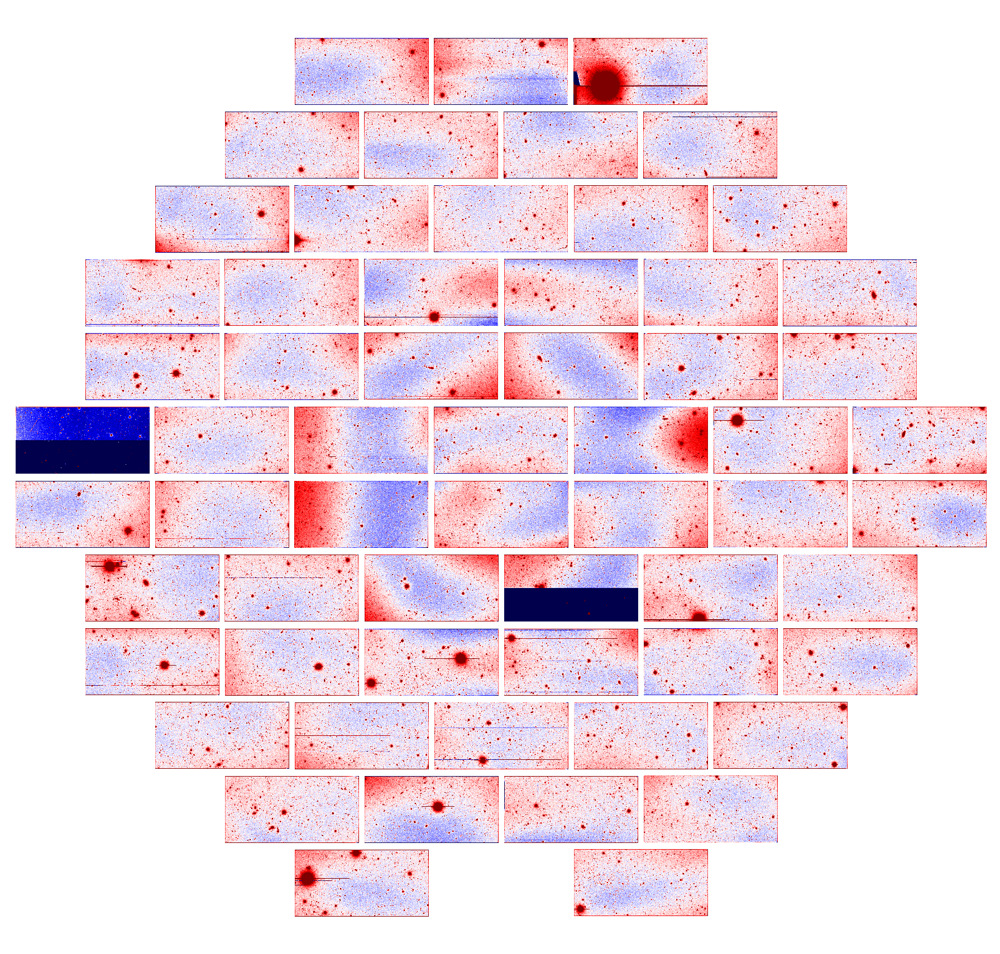

In [8]:
plt.figure(figsize=(25, 23.86))

for ii, ccdnum in enumerate(ccdnum_list):
    
    try:
        img = fits.getdata(img_new_fn, extname=ccdnamenumdict_inv[ccdnum])
    except:
        continue
    ysize, xsize = img.shape        
    ra, dec = ccd_ra[ii], ccd_dec[ii]

    idx = np.where((fringe_table['expnum']==expnum) & (fringe_table['ccdnum']==ccdnum))[0]
    if len(idx)!=1:
        print('CCD{} not found in fringe_table'.format(ccdnum))
        mask = (fringe_table['expnum']==expnum)
        median_sky = np.median(fringe_table['median_sky'][mask])
        sky_nmad = np.median(fringe_table['sky_nmad'][mask])
    else:
        median_sky = fringe_table['median_sky'][idx]
        sky_nmad = fringe_table['sky_nmad'][idx]
    
    img1 = img - median_sky
    img1[~np.isfinite(img1)] = 0
    img1 = gaussian_filter(img1, 3, mode='reflect', truncate=3)
    fig = plt.imshow(img1.T, cmap='seismic', vmin=-1.5*sky_nmad, vmax=1.5*sky_nmad, 
               extent=(ra-ysize*pix_size/2, ra+ysize*pix_size/2, dec-xsize*pix_size/2, dec+xsize*pix_size/2))

plt.axis([1.1, -1.1, -1.05, 1.05])
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
# plt.savefig('new_image.png')
plt.show()

## A different exposure

In [9]:
expnum = expnum_list[0]
# expnum = 767653
print('expnum:', expnum)

# Find an arbitrary CCD in the exposure to get the image filename
ccd_index = np.where((ccd['expnum']==expnum))[0][0]

frgscale_path = os.path.join(frgscale_dir, ccd['image_filename'][ccd_index].strip().replace('.fits.fz', '.txt'))
img_old_fn = os.path.join(img_old_dir, ccd['image_filename'][ccd_index].strip())
img_new_fn = os.path.join(img_new_dir, ccd['image_filename'][ccd_index].strip())
print(img_new_fn)

fringe_table = Table.read(frgscale_path, format='ascii.commented_header')

expnum: 347527
/global/cscratch1/sd/rongpu/fringe/fringe_corrected_image/decam/CP/V4.8.2a/CP20140812/c4d_140813_103040_ooi_z_ls9.fits.fz


__Old image__

CCD31 not found in fringe_table


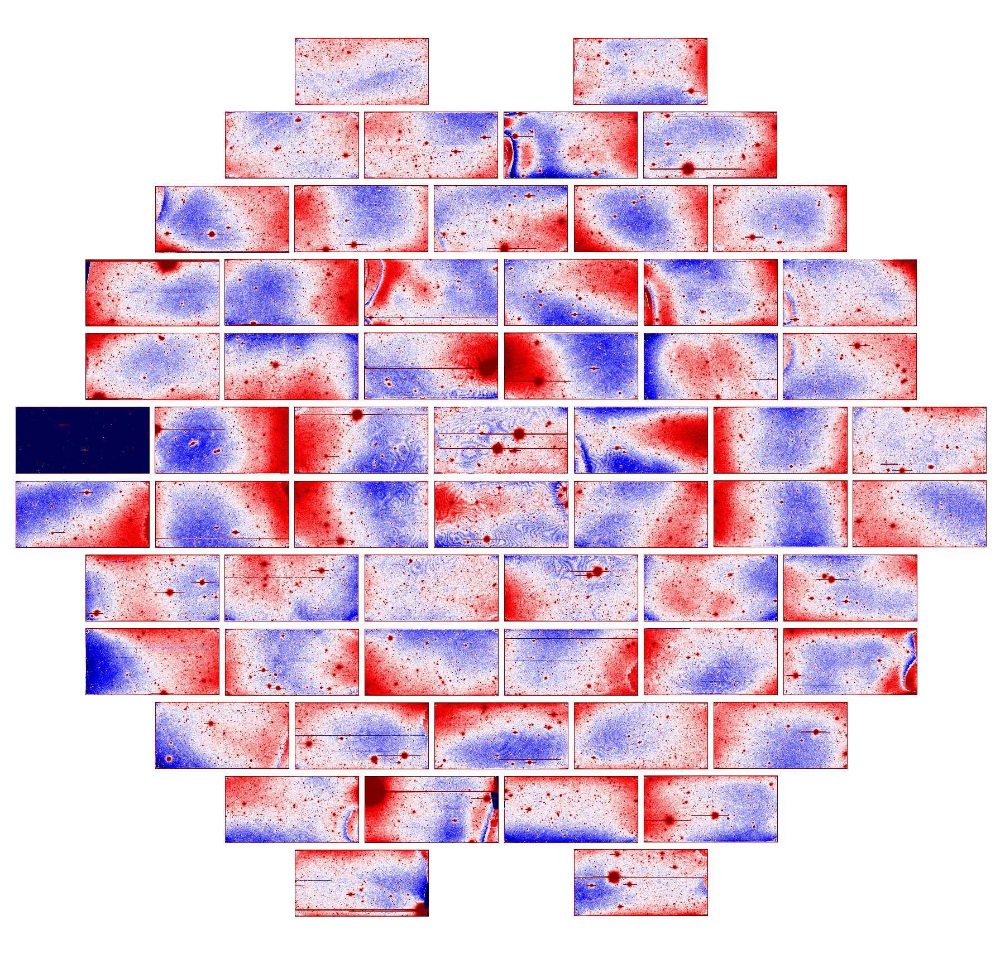

In [10]:
plt.figure(figsize=(25, 23.86))

for ii, ccdnum in enumerate(ccdnum_list):
    
    try:
        img = fits.getdata(img_old_fn, extname=ccdnamenumdict_inv[ccdnum])
    except:
        continue
    ysize, xsize = img.shape        
    ra, dec = ccd_ra[ii], ccd_dec[ii]

    idx = np.where((fringe_table['expnum']==expnum) & (fringe_table['ccdnum']==ccdnum))[0]
    if len(idx)!=1:
        print('CCD{} not found in fringe_table'.format(ccdnum))
        mask = (fringe_table['expnum']==expnum)
        median_sky = np.median(fringe_table['median_sky'][mask])
        sky_nmad = np.median(fringe_table['sky_nmad'][mask])
    else:
        median_sky = fringe_table['median_sky'][idx]
        sky_nmad = fringe_table['sky_nmad'][idx]
    
    img1 = img - median_sky
    img1[~np.isfinite(img1)] = 0
    img1 = gaussian_filter(img1, 3, mode='reflect', truncate=3)
    fig = plt.imshow(img1.T, cmap='seismic', vmin=-1.5*sky_nmad, vmax=1.5*sky_nmad, 
               extent=(ra-ysize*pix_size/2, ra+ysize*pix_size/2, dec-xsize*pix_size/2, dec+xsize*pix_size/2))

plt.axis([1.1, -1.1, -1.05, 1.05])
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
# plt.savefig('old_image.png')
plt.show()

__New image__

CCD31 not found in fringe_table


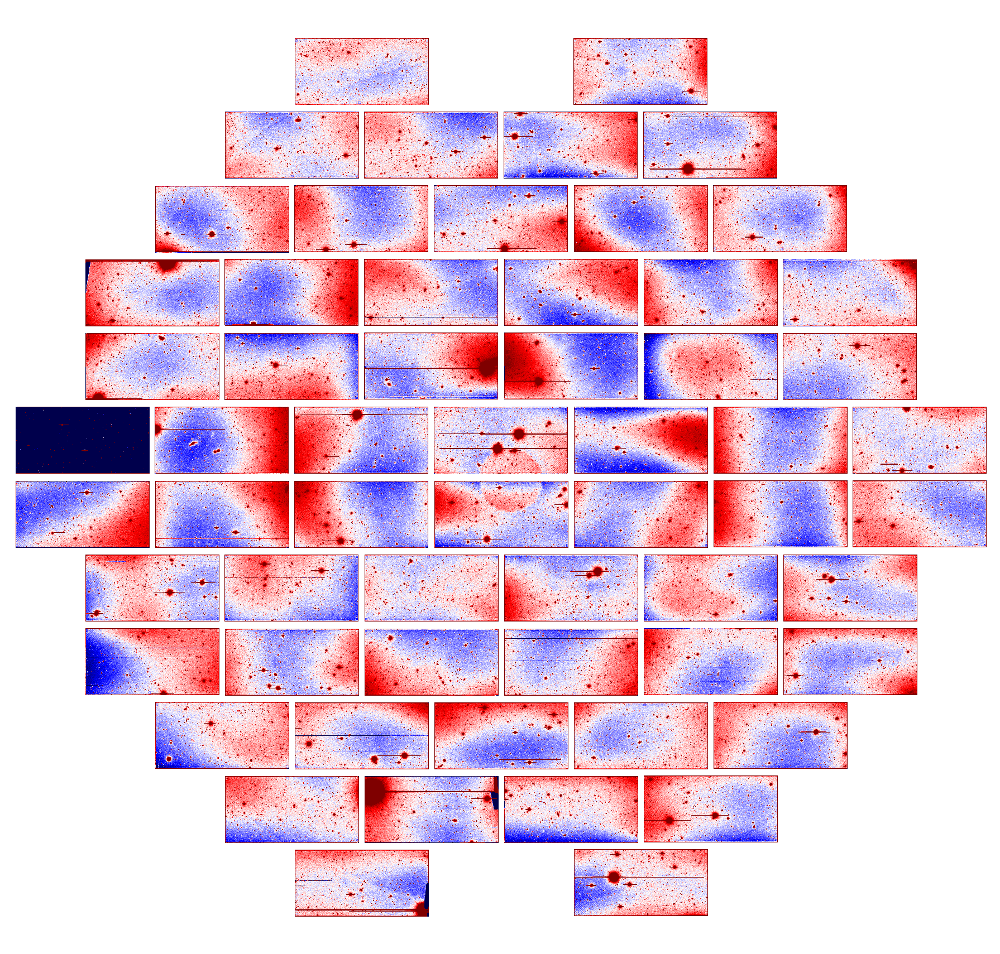

In [11]:
plt.figure(figsize=(25, 23.86))

for ii, ccdnum in enumerate(ccdnum_list):
    
    try:
        img = fits.getdata(img_new_fn, extname=ccdnamenumdict_inv[ccdnum])
    except:
        continue
    ysize, xsize = img.shape        
    ra, dec = ccd_ra[ii], ccd_dec[ii]

    idx = np.where((fringe_table['expnum']==expnum) & (fringe_table['ccdnum']==ccdnum))[0]
    if len(idx)!=1:
        print('CCD{} not found in fringe_table'.format(ccdnum))
        mask = (fringe_table['expnum']==expnum)
        median_sky = np.median(fringe_table['median_sky'][mask])
        sky_nmad = np.median(fringe_table['sky_nmad'][mask])
    else:
        median_sky = fringe_table['median_sky'][idx]
        sky_nmad = fringe_table['sky_nmad'][idx]
    
    img1 = img - median_sky
    img1[~np.isfinite(img1)] = 0
    img1 = gaussian_filter(img1, 3, mode='reflect', truncate=3)
    fig = plt.imshow(img1.T, cmap='seismic', vmin=-1.5*sky_nmad, vmax=1.5*sky_nmad, 
               extent=(ra-ysize*pix_size/2, ra+ysize*pix_size/2, dec-xsize*pix_size/2, dec+xsize*pix_size/2))

plt.axis([1.1, -1.1, -1.05, 1.05])
plt.axis('off')
fig.axes.get_xaxis().set_visible(False)
fig.axes.get_yaxis().set_visible(False)
plt.tight_layout()
# plt.savefig('new_image.png')
plt.show()